In [21]:
import pandas as pd
import numpy as np
import os
import glob
import seaborn as sns

In [2]:
#model_folder = 'models/02_03_21-15/architectures_cpc.cpc_combined.CPCCombined'
#model_folder = 'models/02_03_21-15/architectures_cpc.cpc_combined.CPCCombined'
#model_folder = 'models/09_03_21-18/architectures_cpc.cpc_combined.CPCCombined'
#model_folder = 'models/10_03_21-18/architectures_cpc.cpc_combined.CPCCombined1'
#model_folder = '/home/julian/Downloads/Github/contrastive-predictive-coding/models/16_03_21-17/architectures_cpc.cpc_combined.CPCCombined0'
model_folder = '/home/julian/Downloads/Github/contrastive-predictive-coding/models/16_08_21-10-16-test|(40x)cpc/14_08_21-15_36-train|(4x)cpc/architectures_cpc.cpc_combined.CPCCombined2|train-test-splits-fewer-labels60|use_weights|unfrozen|C|m:all|cpc_downstream_cnn'

In [3]:
pred_path = glob.glob(os.path.join(model_folder ,'*output.csv'))[0]
dfp = pd.read_csv(pred_path)
pred = dfp.values[:, 1:]
dfp

,Unnamed: 0,10370003,11157007,111975006,164861001,164865005,164867002,164873001,164884008,164889003,...,63593006,6374002,67198005,67741000119109,698252002,713422000,713426002,713427006,74390002,89792004
0,/media/julian/data/data/ECG/ptbxl_challenge/HR...,0.000333,0.000956,0.019975,0.010873,0.074232,0.010617,0.025496,0.009704,0.008610,...,0.001236,0.000215,0.000029,0.011185,0.026917,0.000104,0.001759,0.000052,0.000066,0.000191
1,/media/julian/data/data/ECG/ptbxl_challenge/HR...,0.000930,0.004560,0.013027,0.018212,0.079470,0.008430,0.010485,0.127720,0.172605,...,0.024956,0.001059,0.000006,0.016636,0.011573,0.000084,0.006981,0.000559,0.000108,0.001634
2,/media/julian/data/data/ECG/ptbxl_challenge/HR...,0.000063,0.000660,0.019547,0.022087,0.037891,0.019960,0.180355,0.014676,0.034115,...,0.000509,0.000015,0.000072,0.029602,0.014867,0.000359,0.025970,0.000791,0.000354,0.000275
3,/media/julian/data/data/ECG/ptbxl_challenge/HR...,0.000027,0.000165,0.217853,0.104753,0.013420,0.010242,0.021190,0.009752,0.085852,...,0.000276,0.000020,0.000035,0.030892,0.013179,0.000437,0.033761,0.006104,0.000029,0.002814
4,/media/julian/data/data/ECG/ptbxl_challenge/HR...,0.000626,0.000553,0.018315,0.001648,0.031800,0.009988,0.008634,0.015942,0.008793,...,0.004771,0.000741,0.000271,0.015365,0.005547,0.000359,0.006099,0.000131,0.000123,0.000723
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8437,/media/julian/data/data/ECG/china_challenge/Q2289,0.000094,0.000204,0.027954,0.143319,0.222282,0.078769,0.272639,0.023970,0.161740,...,0.003473,0.001105,0.000012,0.072298,0.041522,0.004884,0.004581,0.000344,0.000018,0.000450
8438,/media/julian/data/data/ECG/china_challenge/Q2565,0.000111,0.000289,0.020319,0.013210,0.015619,0.007116,0.070466,0.026711,0.008593,...,0.001007,0.000349,0.000007,0.027856,0.005870,0.000087,0.011458,0.002290,0.000621,0.001430
8439,/media/julian/data/data/ECG/china_challenge/Q1927,0.000101,0.000261,0.008309,0.003686,0.096263,0.037706,0.104612,0.019850,0.018145,...,0.000458,0.000284,0.000074,0.010211,0.009146,0.000274,0.013402,0.000762,0.000063,0.000345
8440,/media/julian/data/data/ECG/china_challenge/Q1845,0.000519,0.000785,0.102021,0.126415,0.149909,0.046377,0.072142,0.052704,0.129777,...,0.001254,0.000253,0.001408,0.022237,0.026338,0.001729,0.002815,0.000633,0.000038,0.000289


In [9]:
label_path = glob.glob(os.path.join(model_folder ,'labels-dataloader-1.csv'))[0]
print(label_path)
dfl = pd.read_csv(label_path)
labels = dfl.values[:, 1:].astype(int)
dfl

/home/julian/Downloads/Github/contrastive-predictive-coding/models/16_08_21-10-16-test|(40x)cpc/14_08_21-15_36-train|(4x)cpc/architectures_cpc.cpc_combined.CPCCombined2|train-test-splits-fewer-labels60|use_weights|unfrozen|C|m:all|cpc_downstream_cnn/labels-dataloader-1.csv


,Unnamed: 0,10370003,11157007,111975006,164861001,164865005,164867002,164873001,164884008,164889003,...,63593006,6374002,67198005,67741000119109,698252002,713422000,713426002,713427006,74390002,89792004
0,/media/julian/data/data/ECG/ptbxl_challenge/HR...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,/media/julian/data/data/ECG/ptbxl_challenge/HR...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,/media/julian/data/data/ECG/ptbxl_challenge/HR...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,/media/julian/data/data/ECG/ptbxl_challenge/HR...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,/media/julian/data/data/ECG/ptbxl_challenge/HR...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8437,/media/julian/data/data/ECG/china_challenge/Q2289,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8438,/media/julian/data/data/ECG/china_challenge/Q2565,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8439,/media/julian/data/data/ECG/china_challenge/Q1927,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8440,/media/julian/data/data/ECG/china_challenge/Q1845,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [12]:
np.set_printoptions(suppress=True)
np.round(np.sum(pred, axis=0).astype(float), 0).astype(int)

array([  45,   17,  361,  380,  779,  243,  606,  391,  767,   62,  220,
        189,  368,  126,  844,   55,  457,   84,   14,    8,   14,   19,
         44,  117,    5,   28,    8,   11,   17,   23,  634,   10,  471,
        941,   37,  143,  243,  519,   73,   62,   13, 3316,  441,   37,
        216,   31,  835,  435,  273,   32,   21,    9,   62,   69,  113,
        616,  236,   40,   28,    4,  281,  157,   10,  229,  108,   14,
         40])

In [11]:
np.sum(labels, axis=0)

array([  61,   19,  283,  494, 1128,  228,  753,  379,  684,   58,  205,
        190,  289,   83,  928,   66,  696,   74,   10,    7,   12,   14,
         39,  110,    4,   29,    8,   10,   14,   22,  478,    9,  358,
       1227,   29,  131,  212,  464,   67,   53,   11, 4149,  476,   38,
        251,   26,  702,  408,  354,   39,   22,    6,   92,   84,  155,
        478,  220,   40,   24,    4,  241,  198,    7,  338,  134,   16,
         45])

## Calculate ROC

In [13]:
import numpy as np
import matplotlib.pyplot as plt
from itertools import cycle

from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from scipy import interp
from sklearn.metrics import roc_auc_score

In /home/julian/anaconda3/envs/ml/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The text.latex.preview rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In /home/julian/anaconda3/envs/ml/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The mathtext.fallback_to_cm rcparam was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In /home/julian/anaconda3/envs/ml/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: Support for setting the 'mathtext.fallback_to_cm' rcParam is deprecated since 3.3 and will be removed two minor releases later; use 'mathtext.fallback : 'cm' instead.
In /home/julian/anaconda3/envs/ml/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The validate_bool_maybe_none function was deprecated in Matplotlib 3.3 and will be removed two minor releases later.
In /home/julian/anaconda3/en

In [54]:
def plot_roc_singleclass(tpr, fpr, roc_auc, n, fill_area=False):
    plt.figure(dpi=1200)
    lw = 2
    plt.plot(fpr[n], tpr[n], color='darkorange',
             lw=lw, label='ROC curve')
    if fill_area:
        plt.fill_between(fpr[n], tpr[n], label='(Area Under Curve = AUC = %0.2f)' % roc_auc[n])
    plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic example')
    plt.legend(loc="lower right")
    plt.show()

In [34]:
def plot_roc_multiclass(tpr, fpr, roc_auc, selection=None, plot_averages=True, plot_legend=True):
    selection = range(n_classes) if selection is None else selection
    all_fpr = np.unique(np.concatenate([fpr[i] for i in selection]))
    lw = 1
    # Then interpolate all ROC curves at this points
    mean_tpr = np.zeros_like(all_fpr)
    for i in selection:
        mean_tpr += interp(all_fpr, fpr[i], tpr[i])

    # Finally average it and compute AUC
    mean_tpr /= len(selection)

    fpr["macro"] = all_fpr
    tpr["macro"] = mean_tpr
    roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

    # Plot all ROC curves
    plt.figure(dpi=1200)
    if plot_averages:
        plt.plot(fpr["micro"], tpr["micro"],
                 label='micro-average ROC curve (area = {0:0.2f})'
                       ''.format(roc_auc["micro"]),
                 color='deeppink', linestyle=':', linewidth=4)

        plt.plot(fpr["macro"], tpr["macro"],
                 label='macro-average ROC curve (area = {0:0.2f})'
                       ''.format(roc_auc["macro"]),
                 color='navy', linestyle=':', linewidth=4)

    colors = sns.color_palette("Paired", len(selection)) #cycle(['aqua', 'darkorange', 'cornflowerblue'])
    for i, color in zip(selection, colors):
        plt.plot(fpr[i], tpr[i], color=color, lw=lw,
                 label='ROC curve of class {0} (area = {1:0.2f})'
                 ''.format(i, roc_auc[i]))

    plt.plot([0, 1], [0, 1], 'k--', lw=lw)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Some extension of Receiver operating characteristic to multi-class')
    plt.tight_layout()
    if plot_legend:
        plt.legend(loc="upper left", bbox_to_anchor=(1.1, 1), fontsize=6)
    plt.show()

Below taken (and changed) from: https://github.com/physionetchallenges/evaluation-2020/blob/master/evaluate_12ECG_score.py

In [17]:
n_classes = labels.shape[1]
fpr = dict()
tpr = dict()
thresholds = dict() #no dict because always the same
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], thresholds[i] = roc_curve(labels[:, i], pred[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
fpr["micro"], tpr["micro"], _ = roc_curve(labels.ravel(), pred.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])


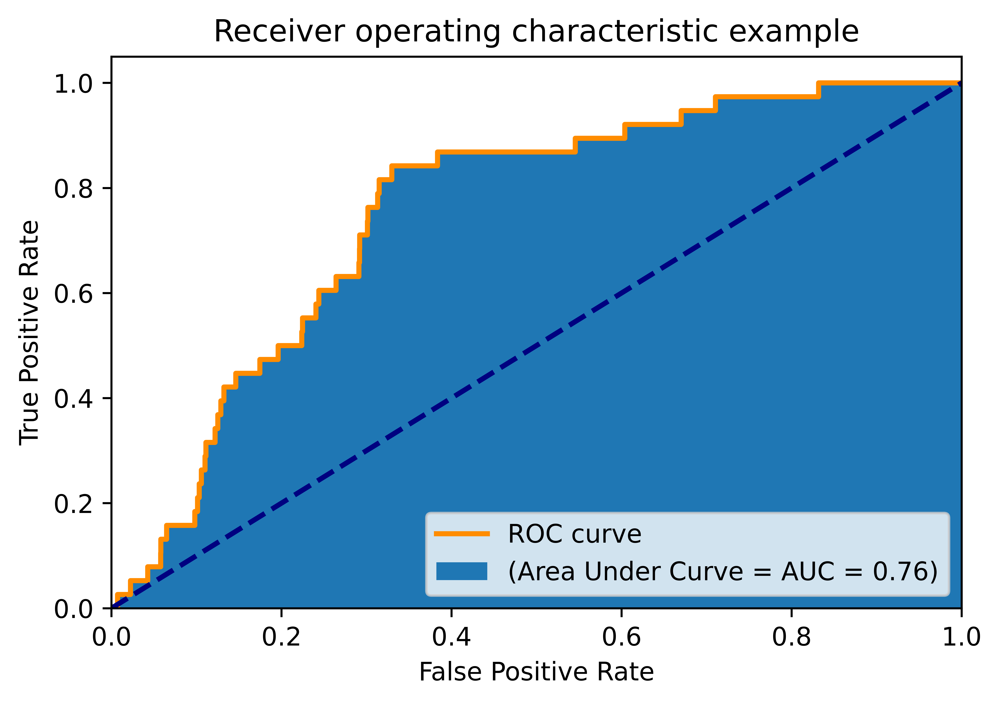

In [55]:
plot_roc_singleclass(tpr, fpr, roc_auc, 43, fill_area=True) #normal class

/home/julian/anaconda3/envs/ml/lib/python3.7/site-packages/ipykernel_launcher.py:8: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  


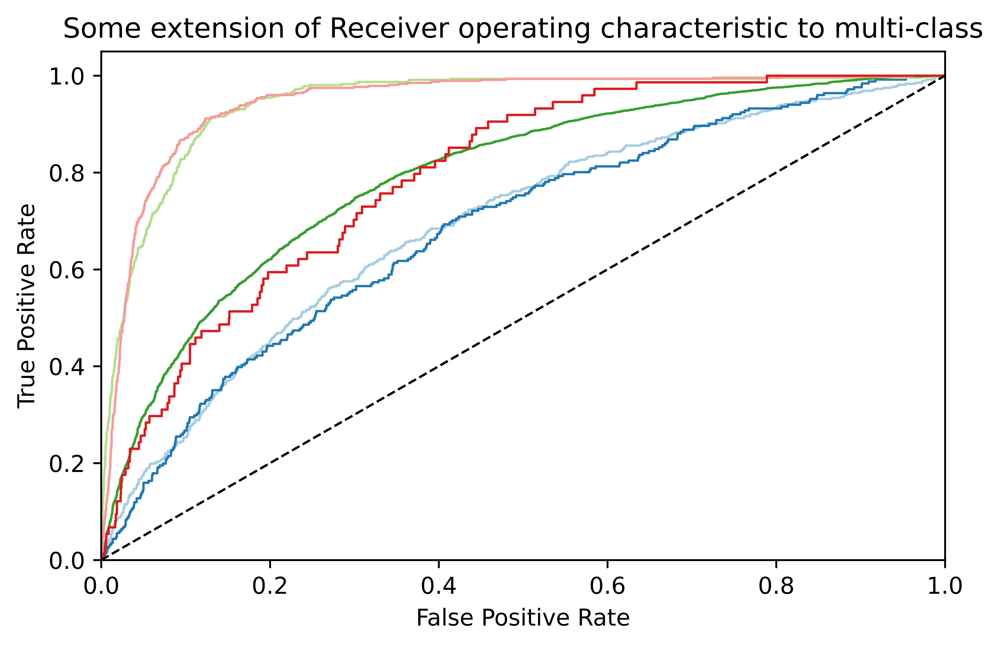

In [53]:
physionetchallenge_sel = '270492004,427393009,426177001,426783006,427084000,17338001'.split(',')
physionetchallenge_sel = [dfl.columns.get_loc(s)-1 for s in physionetchallenge_sel]
plot_roc_multiclass(tpr, fpr, roc_auc, selection=physionetchallenge_sel, plot_averages=False, plot_legend=False)

### Calculate best thresholds for each class

In [37]:
def calculate_best_thresholds(tpr, fpr, thresholds, n_classes):
    best_threshold = dict()
    for i in range(n_classes):
        if np.isnan(fpr[i]).all() or np.isnan(tpr[i]).all():
            best_threshold[i]=np.nan
        else:
            ix = np.argmax(tpr[i]-fpr[i]) #youden J
            #ix = np.argmax(np.sqrt(tpr[i] * (1-fpr[i]))) #gmeans
            best_threshold[i] = thresholds[i][ix]
    return best_threshold

In [38]:
calculate_best_thresholds(tpr, fpr, thresholds, n_classes) #returns nan if tpr or fpr is nan

{0: 0.0017549309,
 1: 0.0030412178,
 2: 0.041722115,
 3: 0.040989157,
 4: 0.08905238,
 5: 0.026690057,
 6: 0.05592311,
 7: 0.06691052,
 8: 0.104915075,
 9: 0.010863,
 10: 0.022098996,
 11: 0.019438677,
 12: 0.03652799,
 13: 0.015516595,
 14: 0.09445694,
 15: 0.005277888,
 16: 0.052041978,
 17: 0.0073776394,
 18: 0.00152748,
 19: 0.00065569073,
 20: 0.0045185247,
 21: 0.0023113482,
 22: 0.0043572052,
 23: 0.01520003,
 24: 0.0006178398,
 25: 0.004971745,
 26: 0.00029942216,
 27: 0.0023463583,
 28: 0.0018643165,
 29: 0.0014960236,
 30: 0.07927347,
 31: 0.00039273905,
 32: 0.04765539,
 33: 0.08143306,
 34: 0.0019931877,
 35: 0.016029479,
 36: 0.025784733,
 37: 0.08003108,
 38: 0.008461347,
 39: 0.0069613624,
 40: 0.0010391774,
 41: 0.3529176,
 42: 0.06706661,
 43: 0.0043236595,
 44: 0.022733998,
 45: 0.003599809,
 46: 0.09018063,
 47: 0.057664778,
 48: 0.038524568,
 49: 0.0027336876,
 50: 0.0024438214,
 51: 0.00033058168,
 52: 0.008197747,
 53: 0.004372137,
 54: 0.010979706,
 55: 0.0912367

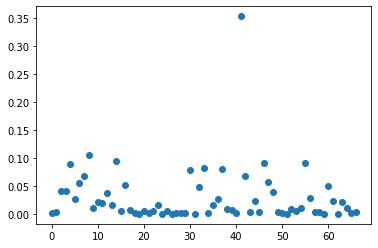

In [39]:
best_thresholds = calculate_best_thresholds(tpr, fpr, thresholds, n_classes)
plt.scatter(best_thresholds.keys(), best_thresholds.values())
best_thresholds = np.array(list(best_thresholds.values()))

### Convert probability scores to binary predictions

In [35]:
""",270492004,164889003,164890007,426627000,713427006,713426002,445118002,39732003,164909002,251146004,698252002,10370003,284470004,427172004,164947007,111975006,164917005,47665007,59118001,427393009,426177001,426783006,427084000,63593006,164934002,59931005,17338001
270492004,1.0,0.3,0.3,0.5,0.4,0.5,0.45,0.45,0.325,0.375,0.45,0.425,0.4625,0.425,0.5,0.35,0.2,0.45,0.4,0.5,0.5,0.45,0.425,0.4625,0.3,0.3,0.425
164889003,0.3,1.0,0.5,0.3,0.4,0.3,0.35,0.35,0.475,0.425,0.35,0.375,0.3375,0.375,0.3,0.45,0.4,0.35,0.4,0.3,0.3,0.25,0.375,0.3375,0.5,0.5,0.375
164890007,0.3,0.5,1.0,0.3,0.4,0.3,0.35,0.35,0.475,0.425,0.35,0.375,0.3375,0.375,0.3,0.45,0.4,0.35,0.4,0.3,0.3,0.25,0.375,0.3375,0.5,0.5,0.375
426627000,0.5,0.3,0.3,1.0,0.4,0.5,0.45,0.45,0.325,0.375,0.45,0.425,0.4625,0.425,0.5,0.35,0.2,0.45,0.4,0.5,0.5,0.45,0.425,0.4625,0.3,0.3,0.425
713427006,0.4,0.4,0.4,0.4,1.0,0.4,0.45,0.45,0.425,0.475,0.45,0.475,0.4375,0.475,0.4,0.45,0.3,0.45,1.0,0.4,0.4,0.35,0.475,0.4375,0.4,0.4,0.475
713426002,0.5,0.3,0.3,0.5,0.4,1.0,0.45,0.45,0.325,0.375,0.45,0.425,0.4625,0.425,0.5,0.35,0.2,0.45,0.4,0.5,0.5,0.45,0.425,0.4625,0.3,0.3,0.425
445118002,0.45,0.35,0.35,0.45,0.45,0.45,1.0,0.5,0.375,0.425,0.5,0.475,0.4875,0.475,0.45,0.4,0.25,0.5,0.45,0.45,0.45,0.4,0.475,0.4875,0.35,0.35,0.475
39732003,0.45,0.35,0.35,0.45,0.45,0.45,0.5,1.0,0.375,0.425,0.5,0.475,0.4875,0.475,0.45,0.4,0.25,0.5,0.45,0.45,0.45,0.4,0.475,0.4875,0.35,0.35,0.475
164909002,0.325,0.475,0.475,0.325,0.425,0.325,0.375,0.375,1.0,0.45,0.375,0.4,0.3625,0.4,0.325,0.475,0.375,0.375,0.425,0.325,0.325,0.275,0.4,0.3625,0.475,0.475,0.4
251146004,0.375,0.425,0.425,0.375,0.475,0.375,0.425,0.425,0.45,1.0,0.425,0.45,0.4125,0.45,0.375,0.475,0.325,0.425,0.475,0.375,0.375,0.325,0.45,0.4125,0.425,0.425,0.45
698252002,0.45,0.35,0.35,0.45,0.45,0.45,0.5,0.5,0.375,0.425,1.0,0.475,0.4875,0.475,0.45,0.4,0.25,0.5,0.45,0.45,0.45,0.4,0.475,0.4875,0.35,0.35,0.475
10370003,0.425,0.375,0.375,0.425,0.475,0.425,0.475,0.475,0.4,0.45,0.475,1.0,0.4625,0.5,0.425,0.425,0.275,0.475,0.475,0.425,0.425,0.375,0.5,0.4625,0.375,0.375,0.5
284470004,0.4625,0.3375,0.3375,0.4625,0.4375,0.4625,0.4875,0.4875,0.3625,0.4125,0.4875,0.4625,1.0,0.4625,0.4625,0.3875,0.2375,0.4875,0.4375,0.4625,0.4625,0.4125,0.4625,1.0,0.3375,0.3375,0.4625
427172004,0.425,0.375,0.375,0.425,0.475,0.425,0.475,0.475,0.4,0.45,0.475,0.5,0.4625,1.0,0.425,0.425,0.275,0.475,0.475,0.425,0.425,0.375,0.5,0.4625,0.375,0.375,1.0
164947007,0.5,0.3,0.3,0.5,0.4,0.5,0.45,0.45,0.325,0.375,0.45,0.425,0.4625,0.425,1.0,0.35,0.2,0.45,0.4,0.5,0.5,0.45,0.425,0.4625,0.3,0.3,0.425
111975006,0.35,0.45,0.45,0.35,0.45,0.35,0.4,0.4,0.475,0.475,0.4,0.425,0.3875,0.425,0.35,1.0,0.35,0.4,0.45,0.35,0.35,0.3,0.425,0.3875,0.45,0.45,0.425
164917005,0.2,0.4,0.4,0.2,0.3,0.2,0.25,0.25,0.375,0.325,0.25,0.275,0.2375,0.275,0.2,0.35,1.0,0.25,0.3,0.2,0.2,0.15,0.275,0.2375,0.4,0.4,0.275
47665007,0.45,0.35,0.35,0.45,0.45,0.45,0.5,0.5,0.375,0.425,0.5,0.475,0.4875,0.475,0.45,0.4,0.25,1.0,0.45,0.45,0.45,0.4,0.475,0.4875,0.35,0.35,0.475
59118001,0.4,0.4,0.4,0.4,1.0,0.4,0.45,0.45,0.425,0.475,0.45,0.475,0.4375,0.475,0.4,0.45,0.3,0.45,1.0,0.4,0.4,0.35,0.475,0.4375,0.4,0.4,0.475
427393009,0.5,0.3,0.3,0.5,0.4,0.5,0.45,0.45,0.325,0.375,0.45,0.425,0.4625,0.425,0.5,0.35,0.2,0.45,0.4,1.0,0.5,0.45,0.425,0.4625,0.3,0.3,0.425
426177001,0.5,0.3,0.3,0.5,0.4,0.5,0.45,0.45,0.325,0.375,0.45,0.425,0.4625,0.425,0.5,0.35,0.2,0.45,0.4,0.5,1.0,0.45,0.425,0.4625,0.3,0.3,0.425
426783006,0.45,0.25,0.25,0.45,0.35,0.45,0.4,0.4,0.275,0.325,0.4,0.375,0.4125,0.375,0.45,0.3,0.15,0.4,0.35,0.45,0.45,1.0,0.375,0.4125,0.25,0.25,0.375
427084000,0.425,0.375,0.375,0.425,0.475,0.425,0.475,0.475,0.4,0.45,0.475,0.5,0.4625,0.5,0.425,0.425,0.275,0.475,0.475,0.425,0.425,0.375,1.0,0.4625,0.375,0.375,0.5
63593006,0.4625,0.3375,0.3375,0.4625,0.4375,0.4625,0.4875,0.4875,0.3625,0.4125,0.4875,0.4625,1.0,0.4625,0.4625,0.3875,0.2375,0.4875,0.4375,0.4625,0.4625,0.4125,0.4625,1.0,0.3375,0.3375,0.4625
164934002,0.3,0.5,0.5,0.3,0.4,0.3,0.35,0.35,0.475,0.425,0.35,0.375,0.3375,0.375,0.3,0.45,0.4,0.35,0.4,0.3,0.3,0.25,0.375,0.3375,1.0,0.5,0.375
59931005,0.3,0.5,0.5,0.3,0.4,0.3,0.35,0.35,0.475,0.425,0.35,0.375,0.3375,0.375,0.3,0.45,0.4,0.35,0.4,0.3,0.3,0.25,0.375,0.3375,0.5,1.0,0.375
17338001,0.425,0.375,0.375,0.425,0.475,0.425,0.475,0.475,0.4,0.45,0.475,0.5,0.4625,1.0,0.425,0.425,0.275,0.475,0.475,0.425,0.425,0.375,0.5,0.4625,0.375,0.375,1.0
"""

',270492004,164889003,164890007,426627000,713427006,713426002,445118002,39732003,164909002,251146004,698252002,10370003,284470004,427172004,164947007,111975006,164917005,47665007,59118001,427393009,426177001,426783006,427084000,63593006,164934002,59931005,17338001\n270492004,1.0,0.3,0.3,0.5,0.4,0.5,0.45,0.45,0.325,0.375,0.45,0.425,0.4625,0.425,0.5,0.35,0.2,0.45,0.4,0.5,0.5,0.45,0.425,0.4625,0.3,0.3,0.425\n164889003,0.3,1.0,0.5,0.3,0.4,0.3,0.35,0.35,0.475,0.425,0.35,0.375,0.3375,0.375,0.3,0.45,0.4,0.35,0.4,0.3,0.3,0.25,0.375,0.3375,0.5,0.5,0.375\n164890007,0.3,0.5,1.0,0.3,0.4,0.3,0.35,0.35,0.475,0.425,0.35,0.375,0.3375,0.375,0.3,0.45,0.4,0.35,0.4,0.3,0.3,0.25,0.375,0.3375,0.5,0.5,0.375\n426627000,0.5,0.3,0.3,1.0,0.4,0.5,0.45,0.45,0.325,0.375,0.45,0.425,0.4625,0.425,0.5,0.35,0.2,0.45,0.4,0.5,0.5,0.45,0.425,0.4625,0.3,0.3,0.425\n713427006,0.4,0.4,0.4,0.4,1.0,0.4,0.45,0.45,0.425,0.475,0.45,0.475,0.4375,0.475,0.4,0.45,0.3,0.45,1.0,0.4,0.4,0.35,0.475,0.4375,0.4,0.4,0.475\n713426002,0.5,0.3,0

In [30]:
def convert_score_to_binary(pred_scores, decision_thresholds):
    return (pred_scores > decision_thresholds).astype(int)

In [34]:
binary_pred = convert_score_to_binary(pred, best_thresholds)#+0.01

In [36]:
#!/usr/bin/env python

# This file contains functions for evaluating algorithms for the 2020 PhysioNet/
# Computing in Cardiology Challenge. You can run it as follows:
#
#   python evaluate_12ECG_score.py labels outputs scores.csv
#
# where 'labels' is a directory containing files with the labels, 'outputs' is a
# directory containing files with the outputs from your model, and 'scores.csv'
# (optional) is a collection of scores for the algorithm outputs.
#
# Each file of labels or outputs must have the format described on the Challenge
# webpage. The scores for the algorithm outputs include the area under the
# receiver-operating characteristic curve (AUROC), the area under the recall-
# precision curve (AUPRC), accuracy (fraction of correct recordings), macro F-
# measure, and the Challenge metric, which assigns different weights to
# different misclassification errors.

import numpy as np, os, os.path, sys

def evaluate_12ECG_score(label_scores_data, label_binary_data, labels):
    # Define the weights, the SNOMED CT code for the normal class, and equivalent SNOMED CT codes.
    weights_file = 'weights.csv'
    normal_class = '426783006'
    equivalent_classes = [['713427006', '59118001'], ['284470004', '63593006'], ['427172004', '17338001']]

    # Load the scored classes and the weights for the Challenge metric.
    print('Loading weights...')
    classes, weights = load_weights(weights_file, []) #equivalent_classes

    # Load the label and output files.
    print('Loading label and output files...')
    
    binary_outputs = label_binary_data
    scalar_outputs = label_scores_data

    # Evaluate the model by comparing the labels and outputs.
    print('Evaluating model...')

    print('- AUROC and AUPRC...')
    auroc, auprc, auroc_classes, auprc_classes = compute_auc(labels, scalar_outputs)

    print('- Accuracy...')
    accuracy = compute_accuracy(labels, binary_outputs)

    print('- F-measure...')
    f_measure, f_measure_classes = compute_f_measure(labels, binary_outputs)

    print('- F-beta and G-beta measures...')
    f_beta_measure, g_beta_measure = compute_beta_measures(labels, binary_outputs, beta=2)

    print('- Challenge metric...(skipped)')
    challenge_metric = compute_challenge_metric(weights, labels, binary_outputs, classes, normal_class)

    print('Done.')

    # Return the results.
    return classes, auroc, auprc, auroc_classes, auprc_classes, accuracy, f_measure, f_measure_classes, f_beta_measure, g_beta_measure, challenge_metric

# Check if the input is a number.
def is_number(x):
    try:
        float(x)
        return True
    except ValueError:
        return False

# Load weights.
def load_weights(weight_file, equivalent_classes):
    # Load the weight matrix.
    rows, cols, values = load_table(weight_file)
    assert(rows == cols)

    # For each collection of equivalent classes, replace each class with the representative class for the set.
    rows = replace_equivalent_classes(rows, equivalent_classes)

    # Check that equivalent classes have identical weights.
    for j, x in enumerate(rows):
        for k, y in enumerate(rows[j+1:]):
            if x==y:
                assert(np.all(values[j, :]==values[j+1+k, :]))
                assert(np.all(values[:, j]==values[:, j+1+k]))

    # Use representative classes.
    classes = [x for j, x in enumerate(rows) if x not in rows[:j]]
    indices = [rows.index(x) for x in classes]
    weights = values[np.ix_(indices, indices)]

    return classes, weights

def load_table(table_file):
    # The table should have the following form:
    #
    # ,    a,   b,   c
    # a, 1.2, 2.3, 3.4
    # b, 4.5, 5.6, 6.7
    # c, 7.8, 8.9, 9.0
    #
    table = list()
    with open(table_file, 'r') as f:
        for i, l in enumerate(f):
            arrs = [arr.strip() for arr in l.split(',')]
            table.append(arrs)

    # Define the numbers of rows and columns and check for errors.
    num_rows = len(table)-1
    if num_rows<1:
        raise Exception('The table {} is empty.'.format(table_file))

    num_cols = set(len(table[i])-1 for i in range(num_rows))
    if len(num_cols)!=1:
        raise Exception('The table {} has rows with different lengths.'.format(table_file))
    num_cols = min(num_cols)
    if num_cols<1:
        raise Exception('The table {} is empty.'.format(table_file))

    # Find the row and column labels.
    rows = [table[0][j+1] for j in range(num_rows)]
    cols = [table[i+1][0] for i in range(num_cols)]

    # Find the entries of the table.
    values = np.zeros((num_rows, num_cols), dtype=np.float64)
    for i in range(num_rows):
        for j in range(num_cols):
            value = table[i+1][j+1]
            if is_number(value):
                values[i, j] = float(value)
            else:
                values[i, j] = float('nan')

    return rows, cols, values

# Compute recording-wise accuracy.
def compute_accuracy(labels, outputs):
    num_recordings, num_classes = np.shape(labels)

    num_correct_recordings = 0
    for i in range(num_recordings):
        if np.all(labels[i, :]==outputs[i, :]):
            num_correct_recordings += 1

    return float(num_correct_recordings) / float(num_recordings)

# Compute confusion matrices.
def compute_confusion_matrices(labels, outputs, normalize=False):
    # Compute a binary confusion matrix for each class k:
    #
    #     [TN_k FN_k]
    #     [FP_k TP_k]
    #
    # If the normalize variable is set to true, then normalize the contributions
    # to the confusion matrix by the number of labels per recording.
    num_recordings, num_classes = np.shape(labels)

    if not normalize:
        A = np.zeros((num_classes, 2, 2))
        for i in range(num_recordings):
            for j in range(num_classes):
                if labels[i, j]==1 and outputs[i, j]==1: # TP
                    A[j, 1, 1] += 1
                elif labels[i, j]==0 and outputs[i, j]==1: # FP
                    A[j, 1, 0] += 1
                elif labels[i, j]==1 and outputs[i, j]==0: # FN
                    A[j, 0, 1] += 1
                elif labels[i, j]==0 and outputs[i, j]==0: # TN
                    A[j, 0, 0] += 1
                else: # This condition should not happen.
                    raise ValueError('Error in computing the confusion matrix.')
    else:
        A = np.zeros((num_classes, 2, 2))
        for i in range(num_recordings):
            normalization = float(max(np.sum(labels[i, :]), 1))
            for j in range(num_classes):
                if labels[i, j]==1 and outputs[i, j]==1: # TP
                    A[j, 1, 1] += 1.0/normalization
                elif labels[i, j]==0 and outputs[i, j]==1: # FP
                    A[j, 1, 0] += 1.0/normalization
                elif labels[i, j]==1 and outputs[i, j]==0: # FN
                    A[j, 0, 1] += 1.0/normalization
                elif labels[i, j]==0 and outputs[i, j]==0: # TN
                    A[j, 0, 0] += 1.0/normalization
                else: # This condition should not happen.
                    raise ValueError('Error in computing the confusion matrix.')

    return A

# Compute macro F-measure.
def compute_f_measure(labels, outputs):
    num_recordings, num_classes = np.shape(labels)

    A = compute_confusion_matrices(labels, outputs)

    f_measure = np.zeros(num_classes)
    for k in range(num_classes):
        tp, fp, fn, tn = A[k, 1, 1], A[k, 1, 0], A[k, 0, 1], A[k, 0, 0]
        if 2 * tp + fp + fn:
            f_measure[k] = float(2 * tp) / float(2 * tp + fp + fn)
        else:
            f_measure[k] = float('nan')

    macro_f_measure = np.nanmean(f_measure)

    return macro_f_measure, f_measure

# Compute F-beta and G-beta measures from the unofficial phase of the Challenge.
def compute_beta_measures(labels, outputs, beta):
    num_recordings, num_classes = np.shape(labels)

    A = compute_confusion_matrices(labels, outputs, normalize=True)

    f_beta_measure = np.zeros(num_classes)
    g_beta_measure = np.zeros(num_classes)
    for k in range(num_classes):
        tp, fp, fn, tn = A[k, 1, 1], A[k, 1, 0], A[k, 0, 1], A[k, 0, 0]
        if (1+beta**2)*tp + fp + beta**2*fn:
            f_beta_measure[k] = float((1+beta**2)*tp) / float((1+beta**2)*tp + fp + beta**2*fn)
        else:
            f_beta_measure[k] = float('nan')
        if tp + fp + beta*fn:
            g_beta_measure[k] = float(tp) / float(tp + fp + beta*fn)
        else:
            g_beta_measure[k] = float('nan')

    macro_f_beta_measure = np.nanmean(f_beta_measure)
    macro_g_beta_measure = np.nanmean(g_beta_measure)

    return macro_f_beta_measure, macro_g_beta_measure

# Compute macro AUROC and macro AUPRC.
def compute_auc(labels, outputs):
    num_recordings, num_classes = np.shape(labels)

    # Compute and summarize the confusion matrices for each class across at distinct output values.
    auroc = np.zeros(num_classes)
    auprc = np.zeros(num_classes)

    for k in range(num_classes):
        # We only need to compute TPs, FPs, FNs, and TNs at distinct output values.
        thresholds = np.unique(outputs[:, k])
        thresholds = np.append(thresholds, thresholds[-1]+1)
        thresholds = thresholds[::-1]
        num_thresholds = len(thresholds)

        # Initialize the TPs, FPs, FNs, and TNs.
        tp = np.zeros(num_thresholds)
        fp = np.zeros(num_thresholds)
        fn = np.zeros(num_thresholds)
        tn = np.zeros(num_thresholds)
        fn[0] = np.sum(labels[:, k]==1)
        tn[0] = np.sum(labels[:, k]==0)

        # Find the indices that result in sorted output values.
        idx = np.argsort(outputs[:, k])[::-1]

        # Compute the TPs, FPs, FNs, and TNs for class k across thresholds.
        i = 0
        for j in range(1, num_thresholds):
            # Initialize TPs, FPs, FNs, and TNs using values at previous threshold.
            tp[j] = tp[j-1]
            fp[j] = fp[j-1]
            fn[j] = fn[j-1]
            tn[j] = tn[j-1]

            # Update the TPs, FPs, FNs, and TNs at i-th output value.
            while i < num_recordings and outputs[idx[i], k] >= thresholds[j]:
                if labels[idx[i], k]:
                    tp[j] += 1
                    fn[j] -= 1
                else:
                    fp[j] += 1
                    tn[j] -= 1
                i += 1

        # Summarize the TPs, FPs, FNs, and TNs for class k.
        tpr = np.zeros(num_thresholds)
        tnr = np.zeros(num_thresholds)
        ppv = np.zeros(num_thresholds)
        for j in range(num_thresholds):
            if tp[j] + fn[j]:
                tpr[j] = float(tp[j]) / float(tp[j] + fn[j])
            else:
                tpr[j] = float('nan')
            if fp[j] + tn[j]:
                tnr[j] = float(tn[j]) / float(fp[j] + tn[j])
            else:
                tnr[j] = float('nan')
            if tp[j] + fp[j]:
                ppv[j] = float(tp[j]) / float(tp[j] + fp[j])
            else:
                ppv[j] = float('nan')

        # Compute AUROC as the area under a piecewise linear function with TPR/
        # sensitivity (x-axis) and TNR/specificity (y-axis) and AUPRC as the area
        # under a piecewise constant with TPR/recall (x-axis) and PPV/precision
        # (y-axis) for class k.
        for j in range(num_thresholds-1):
            auroc[k] += 0.5 * (tpr[j+1] - tpr[j]) * (tnr[j+1] + tnr[j])
            auprc[k] += (tpr[j+1] - tpr[j]) * ppv[j+1]

    # Compute macro AUROC and macro AUPRC across classes.
    macro_auroc = np.nanmean(auroc)
    macro_auprc = np.nanmean(auprc)

    return macro_auroc, macro_auprc, auroc, auprc

# Compute modified confusion matrix for multi-class, multi-label tasks.
def compute_modified_confusion_matrix(labels, outputs):
    # Compute a binary multi-class, multi-label confusion matrix, where the rows
    # are the labels and the columns are the outputs.
    num_recordings, num_classes = np.shape(labels)
    A = np.zeros((num_classes, num_classes))

    # Iterate over all of the recordings.
    for i in range(num_recordings):
        # Calculate the number of positive labels and/or outputs.
        normalization = float(max(np.sum(np.any((labels[i, :], outputs[i, :]), axis=0)), 1))
        # Iterate over all of the classes.
        for j in range(num_classes):
            # Assign full and/or partial credit for each positive class.
            if labels[i, j]:
                for k in range(num_classes):
                    if outputs[i, k]:
                        A[j, k] += 1.0/normalization

    return A

# Compute the evaluation metric for the Challenge.
def compute_challenge_metric(weights, labels, outputs, classes, normal_class):
    num_recordings, num_classes = np.shape(labels)
    normal_index = classes.index(normal_class)

    # Compute the observed score.
    A = compute_modified_confusion_matrix(labels, outputs)
    observed_score = np.nansum(weights * A)

    # Compute the score for the model that always chooses the correct label(s).
    correct_outputs = labels
    A = compute_modified_confusion_matrix(labels, correct_outputs)
    correct_score = np.nansum(weights * A)

    # Compute the score for the model that always chooses the normal class.
    inactive_outputs = np.zeros((num_recordings, num_classes), dtype=np.bool)
    inactive_outputs[:, normal_index] = 1
    A = compute_modified_confusion_matrix(labels, inactive_outputs)
    inactive_score = np.nansum(weights * A)

    if correct_score != inactive_score:
        normalized_score = float(observed_score - inactive_score) / float(correct_score - inactive_score)
    else:
        normalized_score = 0.0

    return normalized_score

def replace_equivalent_classes(classes, equivalent_classes):
    for j, x in enumerate(classes):
        for multiple_classes in equivalent_classes:
            if x in multiple_classes:
                classes[j] = multiple_classes[0] # Use the first class as the representative class.
    return classes

In [35]:
np.sum(binary_pred, axis=0)

array([ 308,    0,  824, 1671, 1487, 1328, 1663, 1639, 1629,  826, 1250,
          0,  181,  214, 2217,    0, 1488,  805, 1548,    0, 1727, 1154,
       1251, 1275,    0, 1099, 2574,  308, 1251, 1189,    0, 1650,    0,
          0, 2441,  519,    0,  217, 2145, 2158, 1027, 1768, 1700,  617,
       2174, 3593,    0, 1339,    0, 1064,  717,  963,  736, 1172, 1094,
          0, 1036,    0,  911, 1849, 3319,  718, 1133,  941,  522, 1747,
       1302,  836,  681, 2120, 3722,  618, 4090, 1082, 2031,  713, 1547,
       1423,  101, 1483,    0, 1258, 1159,    0,  956, 1362,  558,  914,
          0,    0, 1400,    0,    0,  432])

### only use selection of classes and replace rest by normal (weird workaround)


In [60]:
def replace_unwanted_labels_by_normal(labels, selection_ixs, replace_ix=None):
    #Replaces all labels that are not in the selection_ixs with the normal label
    if replace_ix is None:
        new_labels = np.zeros((len(labels), len(selection_ixs)+1))
        replace_ix =  len(selection_ixs)
    else:
        new_labels = np.zeros((len(labels), len(selection_ixs)))
        replace_ix = selection_ixs.index(replace_ix)
    inverted_selection = list(set(list(range(labels.shape[1])))-set(selection_ixs))
    new_labels[:, 0:len(selection_ixs)] = labels[:, selection_ixs]
    new_labels[:, replace_ix] = np.where(np.sum(labels[:, inverted_selection], axis=1)>0, 1, labels[:, replace_ix])
    return new_labels
                                        

In [61]:
physionetchallenge_sel = '270492004,164889003,164890007,426627000,713427006,713426002,445118002,39732003,164909002,251146004,698252002,10370003,284470004,427172004,164947007,111975006,164917005,47665007,59118001,427393009,426177001,426783006,427084000,63593006,164934002,59931005,17338001'.split(',')
physionetchallenge_sel = [dfl.columns.get_loc(s)-1 for s in physionetchallenge_sel]
replace_unwanted_labels_by_normal(labels, physionetchallenge_sel, dfl.columns.get_loc('426783006')-1)

array([[0., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

### Claculate challenge metrics

In [83]:
predr = replace_unwanted_labels_by_normal(pred, physionetchallenge_sel, dfl.columns.get_loc('426783006')-1)
binary_predr = replace_unwanted_labels_by_normal(binary_pred, physionetchallenge_sel, dfl.columns.get_loc('426783006')-1)
labelsr = replace_unwanted_labels_by_normal(labels, physionetchallenge_sel, dfl.columns.get_loc('426783006')-1)
out = evaluate_12ECG_score(predr, binary_predr, labelsr)
classes, auroc, auprc, auroc_classes, auprc_classes, accuracy, f_measure, f_measure_classes, f_beta_measure, g_beta_measure, challenge_metric = out
output_string = 'AUROC,AUPRC,Accuracy,F-measure,Fbeta-measure,Gbeta-measure,Challenge metric\n{:.3f},{:.3f},{:.3f},{:.3f},{:.3f},{:.3f},{:.3f}'.format(auroc, auprc, accuracy, f_measure, f_beta_measure, g_beta_measure, challenge_metric)
class_output_string = 'Classes,{}\nAUROC,{}\nAUPRC,{}\nF-measure,{}'.format(
    ','.join(classes),
    ','.join('{:.3f}'.format(x) for x in auroc_classes),
    ','.join('{:.3f}'.format(x) for x in auprc_classes),
    ','.join('{:.3f}'.format(x) for x in f_measure_classes))


print(output_string)
print('#######################')
print(class_output_string)

Loading weights...
Loading label and output files...
Evaluating model...
- AUROC and AUPRC...
- Accuracy...
- F-measure...
- F-beta and G-beta measures...
- Challenge metric...(skipped)
Done.
AUROC,AUPRC,Accuracy,F-measure,Fbeta-measure,Gbeta-measure,Challenge metric
0.827,0.246,0.009,0.223,0.298,0.111,0.336
#######################
Classes,270492004,164889003,164890007,426627000,713427006,713426002,445118002,39732003,164909002,251146004,698252002,10370003,284470004,427172004,164947007,111975006,164917005,47665007,59118001,427393009,426177001,426783006,427084000,63593006,164934002,59931005,17338001
AUROC,0.737,0.928,0.887,0.904,0.951,0.856,0.939,0.890,0.971,0.770,0.744,0.927,0.641,0.647,0.825,0.793,0.753,0.928,0.943,0.727,0.946,0.500,0.954,0.773,0.813,0.829,0.745
AUPRC,0.121,0.569,0.093,0.081,0.215,0.170,0.400,0.584,0.642,0.084,0.050,0.515,0.062,0.015,0.034,0.127,0.069,0.081,0.646,0.082,0.509,0.488,0.515,0.027,0.319,0.109,0.024
F-measure,0.158,0.503,0.047,0.055,0.166,0.202,0.353,0.526,0

In [78]:
print(predr.shape, labelsr.shape, binary_predr.shape)

(4249, 27) (4249, 27) (4249, 27)


In [81]:
len('270492004,164889003,164890007,426627000,713427006,713426002,445118002,39732003,164909002,251146004,698252002,10370003,284470004,427172004,164947007,111975006,164917005,47665007,59118001,427393009,426177001,426783006,427084000,63593006,164934002,59931005,17338001'.split(','))

27

In [61]:
d = [{'a':[0, 2, 3], 'l':np.array([1,2,3,4,5,6,7])}]*10
df = pd.DataFrame(d)
df

,a,l
0,"[0, 2, 3]","[1, 2, 3, 4, 5, 6, 7]"
1,"[0, 2, 3]","[1, 2, 3, 4, 5, 6, 7]"
2,"[0, 2, 3]","[1, 2, 3, 4, 5, 6, 7]"
3,"[0, 2, 3]","[1, 2, 3, 4, 5, 6, 7]"
4,"[0, 2, 3]","[1, 2, 3, 4, 5, 6, 7]"
5,"[0, 2, 3]","[1, 2, 3, 4, 5, 6, 7]"
6,"[0, 2, 3]","[1, 2, 3, 4, 5, 6, 7]"
7,"[0, 2, 3]","[1, 2, 3, 4, 5, 6, 7]"
8,"[0, 2, 3]","[1, 2, 3, 4, 5, 6, 7]"
9,"[0, 2, 3]","[1, 2, 3, 4, 5, 6, 7]"


In [64]:
df.to_csv('/home/julian/Desktop/csv.csv', index=False)

In [72]:
df = pd.read_csv('/home/julian/Downloads/Github/contrastive-predictive-coding/experiments/data_output/17_08_21-18/14_08_21-15_36-train|(4x)cpc/architectures_cpc.cpc_combined.CPCCombined0|train-test-splits-fewer-labels60|use_weights|frozen|C|m:all|cpc_downstream_cnn/latent_dataframe.csv')

In [92]:
import pickle
with open('/home/julian/Downloads/Github/contrastive-predictive-coding/experiments/data_output/17_08_21-18/14_08_21-15_36-train|(4x)cpc/architectures_cpc.cpc_combined.CPCCombined1|train-test-splits-fewer-labels60|use_weights|strided|frozen|C|m:all|cpc_downstream_cnn/latent_List.pickle', 'rb') as f:
    latent_list = pickle.load(f)

In [96]:
latent_list[0]['latents'].shape

(9, 1, 128)

In [97]:
latent_list[0]['context'].shape

(1, 256)

In [105]:
all_latents = np.concatenate([np.squeeze(l['latents']) for l in latent_list], axis=0)

In [106]:
all_latents.shape

(113643, 128)

In [109]:
import seaborn as sns

In [108]:
import numpy as np
from sklearn.manifold import TSNE
X_embedded = TSNE(n_components=2, n_jobs=6).fit_transform(all_latents)
X_embedded.shape

(113643, 2)

In [126]:
X_embedded[:,0].shape

(113643,)

In [141]:
first_labels = [item for sublist in [[1]*9 if 41 in l['labels'][1] else [0]*9 for l in latent_list] for item in sublist]

[Text(0.5, 1.0, 'MNIST data T-SNE projection')]

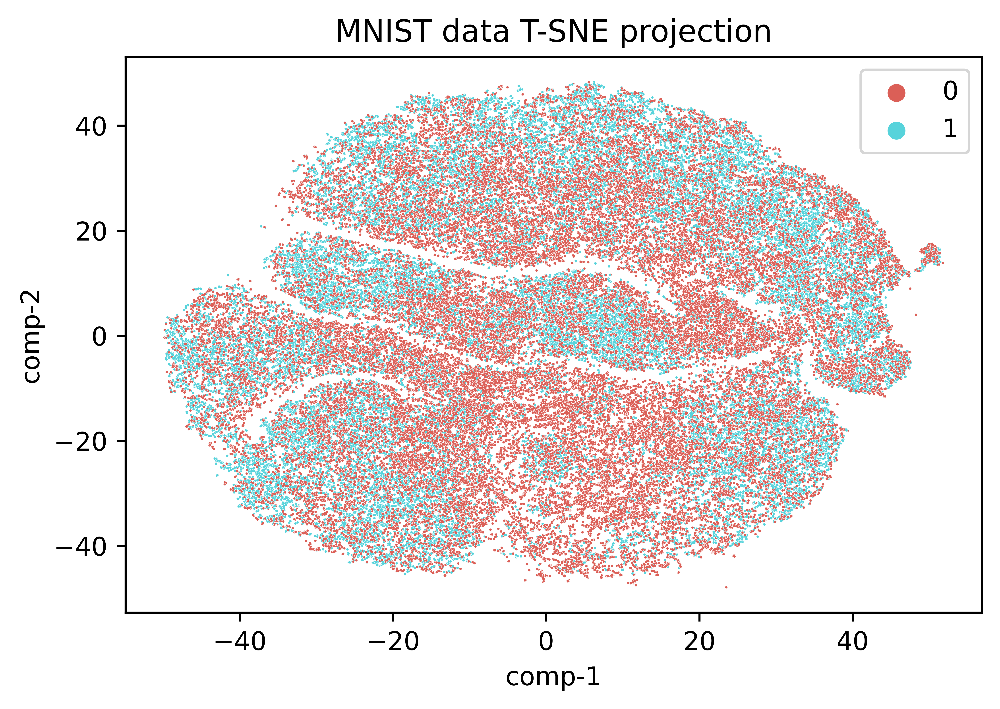

In [143]:
df = pd.DataFrame()
df["y"] = first_labels
df["comp-1"] = X_embedded[:,0]
df["comp-2"] = X_embedded[:,1]
plt.figure(dpi=1200)
sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                palette=sns.color_palette("hls", 2),
                data=df, s=1).set(title="Latent data T-SNE projection")
 

In [156]:
all_contexts = np.stack([np.squeeze(l['context']) for l in latent_list], axis=0)
labels = [1 if 41 in l['labels'][1] else 0 for l in latent_list]
C_embedded = TSNE(n_components=2, n_jobs=6).fit_transform(all_contexts)
C_embedded.shape

(12627, 2)

[Text(0.5, 1.0, 'Context data T-SNE projection')]

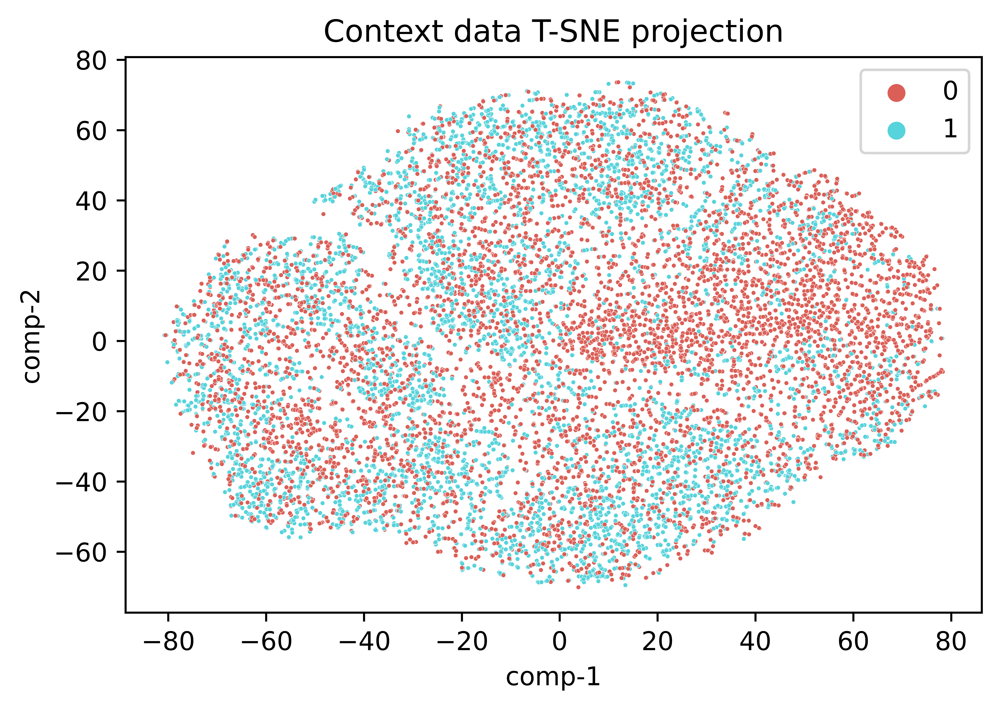

In [161]:

df = pd.DataFrame()
df["y"] = labels
df["comp-1"] = C_embedded[:,0]
df["comp-2"] = C_embedded[:,1]
plt.figure(dpi=1200)
sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                palette=sns.color_palette("hls", 2),
                data=df, s=3).set(title="Context data T-SNE projection")
 